In [1]:
# 06/07/2016
# Author: Dan Iter, Lan Huong Nguyen
import os 
import cv2
import numpy as np
import glob
import matplotlib.pyplot as plt
print os.getcwd()

/Users/lanhuongnguyen/Dropbox/STANFORD/classes/CS 373 Stat Machine Learning for Genomics/project/data


In [2]:
# Load and normalized the data
tmp = []
for f in glob.glob("/afs/cs.stanford.edu/u/daniter/gene/deeplearning/numpy/*.npy"):
    l = np.load(f)
    data_255 = l / l.max() * 255
    data_255  = data_255.astype('uint8')
    tmp.append(data_255)
data = np.array(tmp)

In [5]:
print data[0].shape

(100, 100)


In [3]:
# Use SIFT to discover interesting featires e.g. corners
sift = cv2.SIFT()
all_desc = []
kp_lst  = []
for datum in data:
    kp, desc = sift.detectAndCompute(datum, None)
    kp_lst.append(kp)
    if kp is None or desc is None:
        pass
    else:
        for d in desc:
            all_desc.append(d)
all_desc = np.array(all_desc)



(30649, 128)


In [ ]:
# Use SURF to discover interesting featires e.g. corners
surf = cv2.SURF()
all_desc2 = []
kp_lst2  = []
for datum in data:
    kp, desc = surf.detectAndCompute(datum, None)
    kp_lst2.append(kp)
    if kp is None or desc is None:
        pass
    else:
        for d in desc:
            all_desc2.append(d)
all_desc2 = np.array(all_desc2)

print(all_desc.shape)


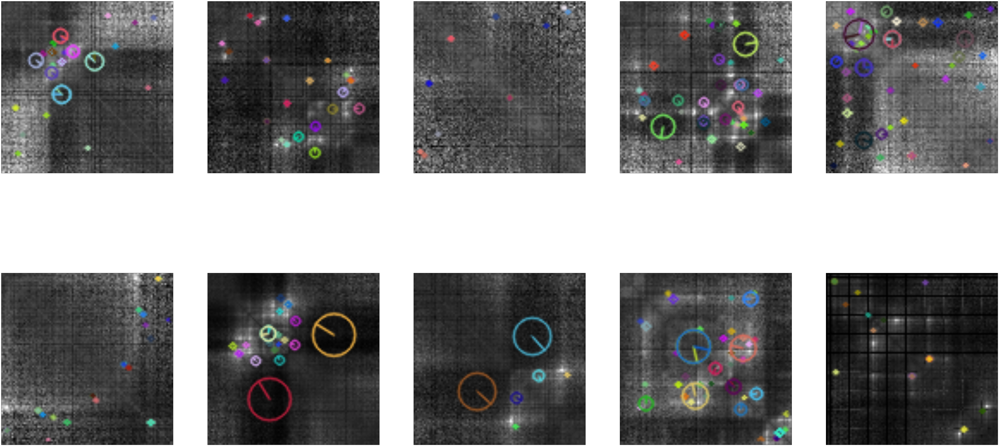

In [4]:
n = 10  # how many windows we will display
# Randomly select the images to display
IDX = np.unique(np.random.randint(low=0, high=len(data), size=30))

%matplotlib inline
plt.figure( figsize=(100, 50)) # figsize=(20, 4)
for i in range(n):
    img = cv2.drawKeypoints(data[IDX[i]],kp_lst[IDX[i]], flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    # display original
    ax = plt.subplot(2, n/2, i+1)
    plt.imshow(img)
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()


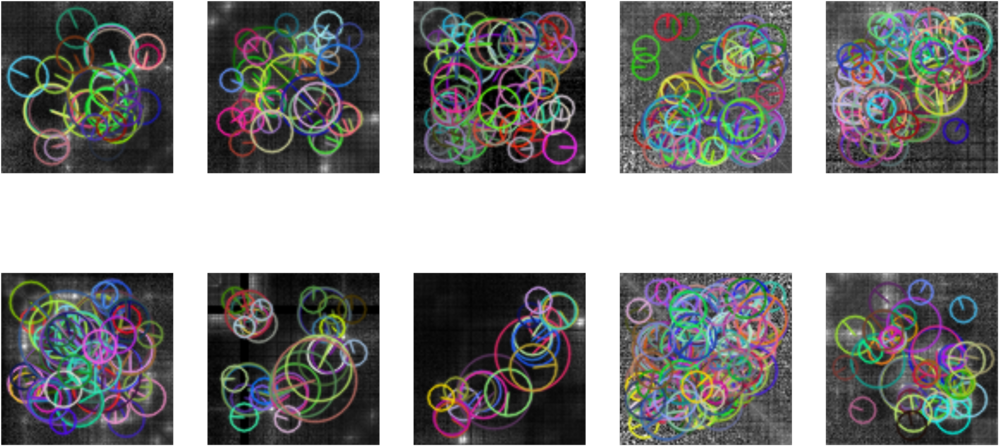

In [12]:
%matplotlib inline
plt.figure( figsize=(100, 50)) # figsize=(20, 4)
for i in range(n):
    img = cv2.drawKeypoints(data[IDX[i]],kp_lst2[IDX[i]], flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    # display original
    ax = plt.subplot(2, n/2, i+1)
    plt.imshow(img)
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()

In [5]:
# Aggregate and cluster the desc features detected by SIFT
from sklearn.cluster import KMeans
km = KMeans(n_clusters=200)
km.fit(all_desc)

KMeans(copy_x=True, init='k-means++', max_iter=300, n_clusters=200, n_init=10,
    n_jobs=1, precompute_distances='auto', random_state=None, tol=0.0001,
    verbose=0)

print(km.labels_)
print(km.labels_.shape)

In [28]:
print(km.labels_[20:40]) 
print(km.labels_.shape)

[ 30 199 128  35   5 147   3 111 142  87   8 172 172 110 142 110   8 111
 169 133]
(30649,)


In [6]:
# Compute the bag of words
labels = [None]*len(data)
i = 0
for datum in data:
    kp, desc = sift.detectAndCompute(datum, None)
    if kp is None or desc is None:
        labels[i] = [0]*200
    else:
        vec = [0]*200
        for d in desc:
            vec[km.predict([d])] += 1
        labels[i] = [v * 1.0 /sum(vec) for v in vec]
    i+=1


/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:11: VisibleDeprecationWarning: converting an array with ndim > 0 to an index will result in an error in the future


In [81]:
labels = np.array(labels)
print labels.shape
print labels

(1088, 200)
[[ 0.          0.00925926  0.         ...,  0.05555556  0.05555556
   0.00925926]
 [ 0.          0.03333333  0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]
 ..., 
 [ 0.          0.          0.03225806 ...,  0.06451613  0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.01694915  0.        ]]


In [28]:
# [KMEANs] Cluster the images based on the labelling computed
image_clust = KMeans(n_clusters=6)
image_clust.fit(labels)

for i in range(6):
    print len([x for x in range(len(image_clust.labels_)) if image_clust.labels_[x] == i])

529
294
192
37
21
15


In [29]:
# Learn the manifold where the labels lie in
from time import time
from matplotlib.ticker import NullFormatter
from sklearn import manifold, decomposition

n_components = 2

t0 = time()
mds = manifold.MDS(n_components=n_components, metric = True)
trans_data = mds.fit_transform(labels).T
t1 = time()
print("MDS: %.2g sec" % (t1 - t0))


MDS: 45 sec


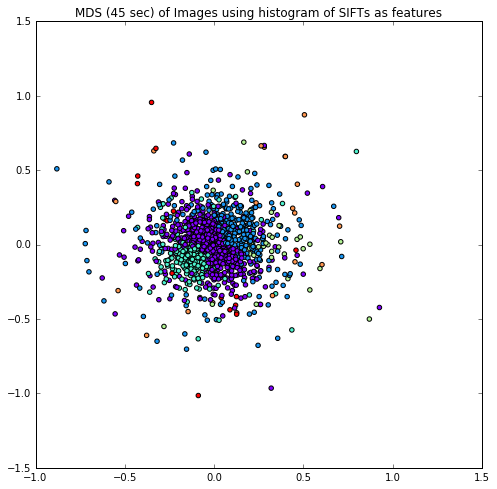

In [30]:
%matplotlib inline

plt.figure( figsize=(8, 8)) 
plt.scatter(trans_data[0], trans_data[1], c=image_clust.labels_, cmap=plt.cm.rainbow)
plt.title("MDS (%.2g sec) of Images using histogram of SIFTs as features" % (t1 - t0))
ax.xaxis.set_major_formatter(NullFormatter())
ax.yaxis.set_major_formatter(NullFormatter())


In [31]:
t0 = time()
tsne = manifold.TSNE(n_components=n_components, init='pca', random_state=0)
Y = tsne.fit_transform(labels)
t1 = time()
print("t-SNE: %.2g sec" % (t1 - t0))


t-SNE: 9.6 sec


(-23.563590338216372,
 20.309111353200343,
 -20.803494385586546,
 23.587447090961607)

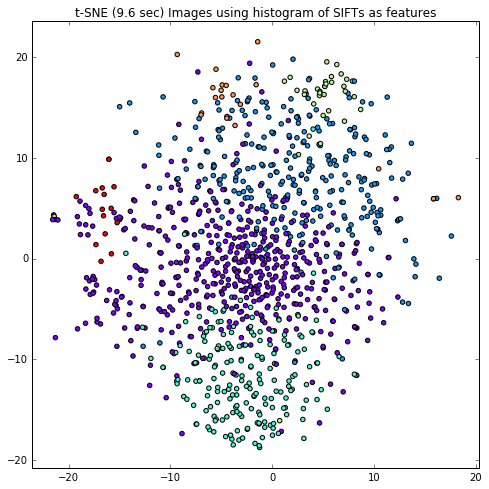

In [32]:
plt.figure( figsize=(8, 8)) 
plt.scatter(Y[:, 0], Y[:, 1], c=image_clust.labels_, cmap=plt.cm.rainbow)
plt.title("t-SNE (%.2g sec) Images using histogram of SIFTs as features" % (t1 - t0))
ax.xaxis.set_major_formatter(NullFormatter())
ax.yaxis.set_major_formatter(NullFormatter())
plt.axis('tight')

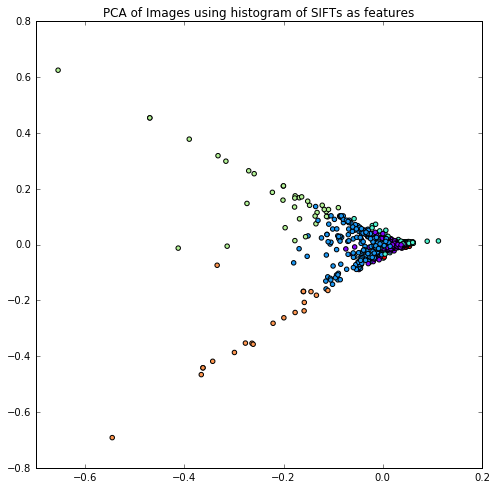

In [33]:
pca = decomposition.PCA(n_components=n_components)
pca.fit(labels)
trans_data_pca = pca.transform(labels)

plt.figure( figsize=(8, 8)) 
plt.scatter(trans_data_pca[:, 0], trans_data_pca[:, 1], c=image_clust.labels_, cmap=plt.cm.rainbow)
plt.title("PCA of Images using histogram of SIFTs as features")
ax.xaxis.set_major_formatter(NullFormatter())
ax.yaxis.set_major_formatter(NullFormatter())

529


/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:12: RuntimeWarning: divide by zero encountered in log


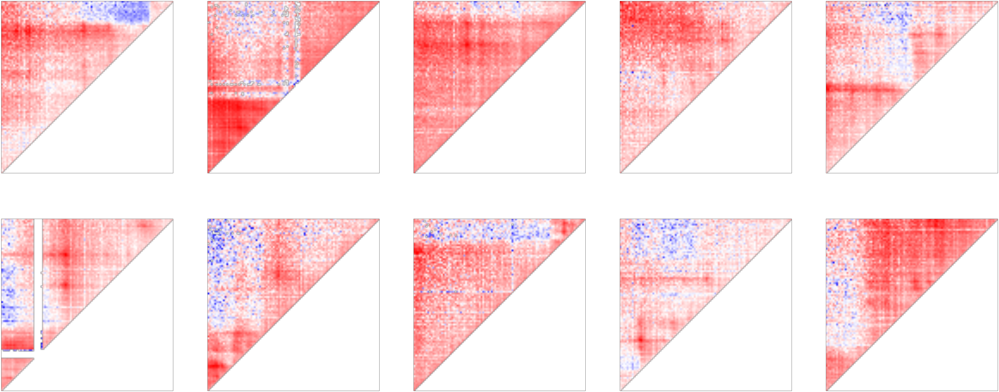

In [58]:
%matplotlib inline

# Class 0
n = 10
IDX = [x for x in range(len(image_clust.labels_)) if image_clust.labels_[x] == 0]
rand = np.unique(np.random.randint(low=0, high=len(IDX), size=30))
print len(IDX)
plt.figure( figsize=(100, 40)) 
for i in range(n):
    # display original
    ax = plt.subplot(2, n/2, i+1)
    dat  = np.log(np.tril(data[IDX[rand[i]]]*1.0))
    dat = dat[::-1]
    plt.imshow(dat, cmap = "bwr")
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()

294


/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:9: RuntimeWarning: divide by zero encountered in log


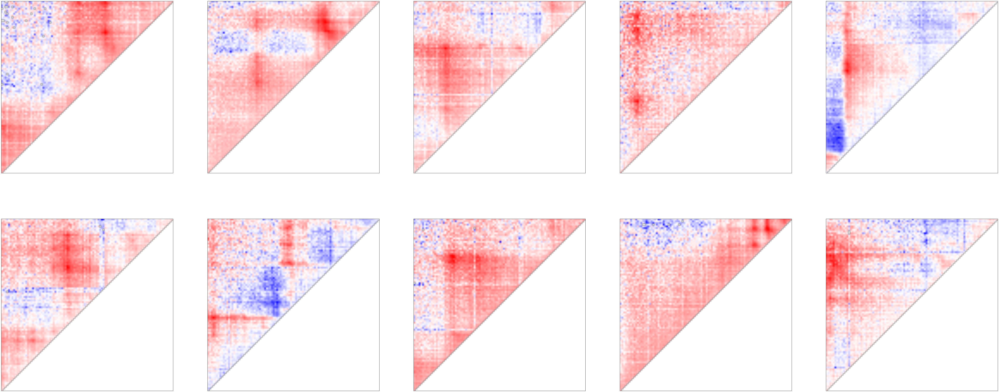

In [59]:
# Class 1
IDX =[x for x in range(len(image_clust.labels_)) if image_clust.labels_[x] == 1]
rand = np.unique(np.random.randint(low=0, high=len(IDX), size=30))
print len(IDX)
plt.figure( figsize=(100, 40)) 
for i in range(n):
    # display original
    ax = plt.subplot(2, n/2, i+1)
    dat  = np.log(np.tril(data[IDX[rand[i]]]*1.0))
    dat = dat[::-1]
    plt.imshow(dat, cmap = "bwr")
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()

192


/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:9: RuntimeWarning: divide by zero encountered in log


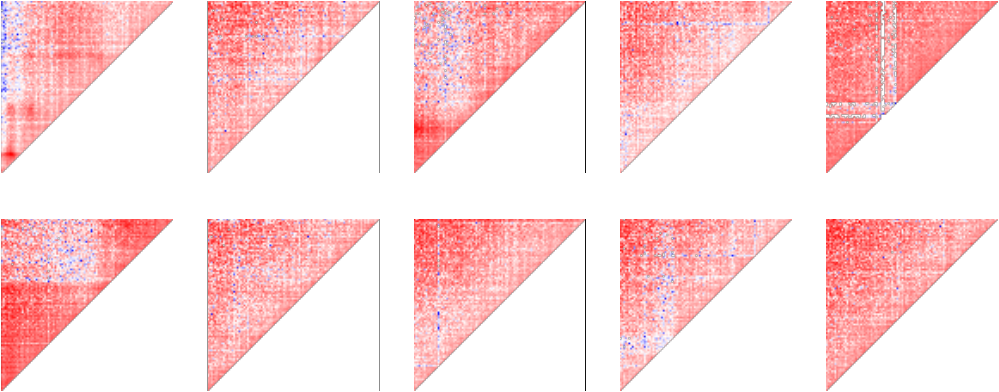

In [60]:
# Class 2
IDX  = [x for x in range(len(image_clust.labels_)) if image_clust.labels_[x] == 2]
rand = np.unique(np.random.randint(low=0, high=len(IDX), size=30))
print len(IDX)
plt.figure( figsize=(100, 40)) 
for i in range(n):
    # display original
    ax = plt.subplot(2, n/2, i+1)
    dat  = np.log(np.tril(data[IDX[rand[i]]]*1.0))
    dat = dat[::-1]
    plt.imshow(dat, cmap = "bwr")
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()

37


/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:9: RuntimeWarning: divide by zero encountered in log


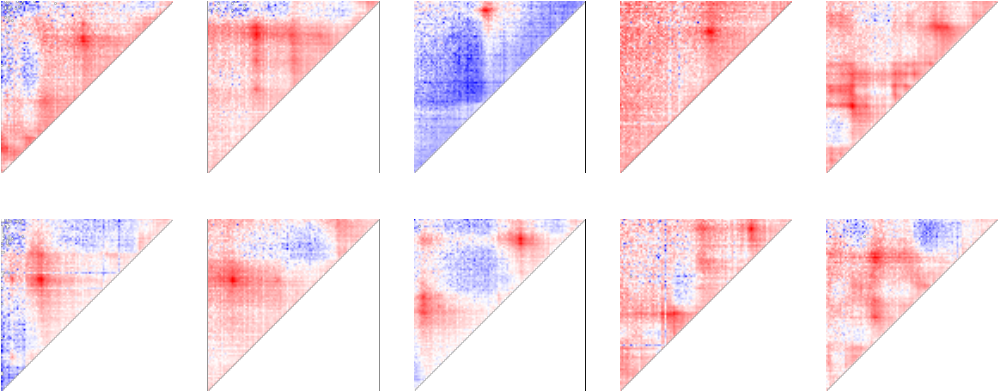

In [61]:
# Class 3
IDX  = [x for x in range(len(image_clust.labels_)) if image_clust.labels_[x] == 3]
rand = np.unique(np.random.randint(low=0, high=len(IDX), size=30))
print len(IDX)
plt.figure( figsize=(100, 40)) 
for i in range(min([n, len(IDX)])):
    # display original
    ax = plt.subplot(2, n/2, i+1)
    dat  = np.log(np.tril(data[IDX[rand[i]]]*1.0))
    dat = dat[::-1]
    plt.imshow(dat, cmap = "bwr")
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()

21


/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:9: RuntimeWarning: divide by zero encountered in log


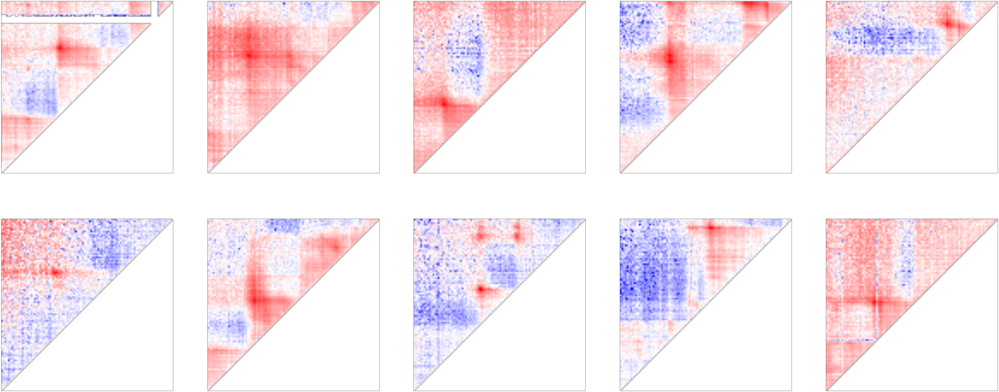

In [64]:
# Class 4
IDX  = [x for x in range(len(image_clust.labels_)) if image_clust.labels_[x] == 4]
rand = np.unique(np.random.randint(low=0, high=len(IDX), size=30))
print len(IDX)
plt.figure( figsize=(100, 40)) 
for i in range(min([n, len(IDX)])):
    # display original
    ax = plt.subplot(2, n/2, i+1)
    dat  = np.log(np.tril(data[IDX[rand[i]]]*1.0))
    dat = dat[::-1]
    plt.imshow(dat, cmap = "bwr")
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()

15


/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:8: RuntimeWarning: divide by zero encountered in log


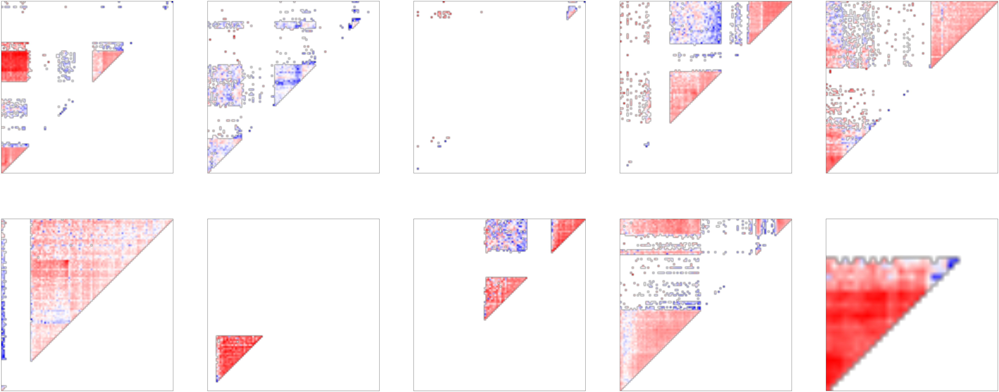

In [66]:
# Class 5
IDX  = [x for x in range(len(image_clust.labels_)) if image_clust.labels_[x] == 5]
print len(IDX)
plt.figure( figsize=(100, 40)) 
for i in range(min([n, len(IDX)])):
    # display original
    ax = plt.subplot(2, n/2, i+1)
    dat  = np.log(np.tril(data[IDX[rand[i]]]*1.0))
    dat = dat[::-1]
    plt.imshow(dat, cmap = "bwr")
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()
